In [1]:
import datetime as dt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import MathsUtilities as MUte
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols
import matplotlib.dates as mdates
import CAMP as camp
import copy
import json
from scipy.optimize import curve_fit
pd.set_option('display.max_rows',1000)
%matplotlib inline

## Bring in data

In [2]:
VarNameMap = {'[Phenology].CAMP.FLNparams.CL': 'FLN_CL',
              '[Phenology].CAMP.FLNparams.WL': 'FLN_WL',
              '[Phenology].CAMP.FLNparams.CS': 'FLN_CS',
              '[Phenology].CAMP.FLNparams.WS': 'FLN_WS',
              'VrnTreatTemp': 'VrnTreatTemp',
              'VrnTreatDuration': 'VrnTreatDuration',
              'Expt': 'Expt'}

In [3]:
LaTrobeCampInputs = pd.read_excel('./DataAnalysis/ProcessedData/CEParamsFLN_Aus.xlsx',sheet_name='ObservedParams',index_col='Cultivar',engine='openpyxl',usecols="A:H")
LaTrobeCampInputs.columns = [VarNameMap[x] for x in LaTrobeCampInputs.columns]
LaTrobeLAData = pd.read_excel('./DataAnalysis/ProcessedData/FinalNPIFitting.xlsx',sheet_name='Phyllo',index_col='Cultivar',engine='openpyxl')
LaTrobeCampInputs.loc[:,'BasePhyllo'] = LaTrobeLAData.loc[:, "[Phenology].Phyllochron.BasePhyllochron.FixedValue"]
LaTrobeCampInputs.loc[:,'PhylloPpSens'] = LaTrobeLAData.loc[:, "[Phenology].PhyllochronPpSensitivity.FixedValue"]
LaTrobeCampInputs.loc[:,'TtEmerge'] = 90
LaTrobeCampInputs.loc[:,'k'] = camp.CampConstants['k']
LaTrobeCampInputs.loc[:,'VIThreshold'] = camp.CampConstants['VIThreshold']
LaTrobeCampInputs.loc[:,'TSThreshold'] = camp.CampConstants['TSThreshold']
LaTrobeCampInputs.loc[:,'PpL'] = 16
LaTrobeCampInputs.loc[:,'Expt'] = 'LaTrobe'

In [4]:
LincolnCampInputs = pd.read_excel('./DataAnalysis/ProcessedData/CEParamsFLN_NZ96.xlsx',sheet_name='ObservedParams',index_col='Cultivar',engine='openpyxl',usecols="A:H")
LincolnCampInputs.columns = [VarNameMap[x] for x in LincolnCampInputs.columns]
LincolnCampInputs.loc[:,'BasePhyllo'] = 100
LincolnCampInputs.loc[:,'PhylloPpSens'] = 0.18
LincolnCampInputs.loc[:,'TtEmerge'] = 90
LincolnCampInputs.loc[:,'k'] = camp.CampConstants['k']
LincolnCampInputs.loc[:,'VIThreshold'] = camp.CampConstants['VIThreshold']
LincolnCampInputs.loc[:,'TSThreshold'] = camp.CampConstants['TSThreshold']
LincolnCampInputs.loc[:,'PpL'] = 16
LincolnCampInputs.loc[:,'Expt'] = 'Lincoln'

In [5]:
CampInputs = pd.concat([LaTrobeCampInputs,LincolnCampInputs])
CampInputs = CampInputs.reindex(sorted(CampInputs.index.values,key=lambda x: x.lower()))

In [6]:
CampInputs.loc['PNBattenWinter',:] = CampInputs.loc['BattenWinter',:] 
CampInputs.loc['PNBattenWinter','FLN_WS'] = CampInputs.loc['BattenWinter','FLN_WS'] + 3.5 ## Correct to be consistent with BnJ Data
CampInputs.loc['PNBattenWinter','FLN_WL'] = CampInputs.loc['BattenWinter','FLN_WL'] + 3.5 ## Correct to be consistent with BnJ Data
CampInputs.loc['oroua','FLN_WS'] = 11 #FLN_WS missing.  No vernalisation response so assume FLN_WS = FLN_CS

In [7]:
CampInputs.to_excel('CampVrnParamInputs.xlsx')

In [8]:
CampVrnParams = CampInputs.loc[:,['FLN_CL','FLN_WL','FLN_CS','FLN_WS']]
for c in CampVrnParams.index:
    CampVrnParams.loc[c,'Expt'] = CampInputs.loc[c,'Expt']
    CampVrnParams.loc[c,'MinLN'] = CampInputs.loc[c,'FLN_CL']
    CampVrnParams.loc[c,'PpLN'] = CampInputs.loc[c,'FLN_CS'] - CampVrnParams.loc[c,'MinLN']
    CampVrnParams.loc[c,'VrnLN'] = CampInputs.loc[c,'FLN_WS'] - CampVrnParams.loc[c,'MinLN'] -CampVrnParams.loc[c,'PpLN']
    CampVrnParams.loc[c,'VxPLN'] = CampInputs.loc[c,'FLN_WL'] - CampVrnParams.loc[c,'MinLN'] - CampVrnParams.loc[c,'VrnLN']

## Janz and Yitpi are common to both CE experiments

In [9]:
def MarkerProperties(g,highlights,Expt):
    if g in highlights:
        col = 'r'
        mark = 's-'
        size = 10
    else:
        col = 'k'
        mark = 'o-'
        size = 7   
    
    if (Expt == 'LaTrobe'):
        fill = col
    else:
        fill = 'white'
    return (col,mark,size,fill)

def SetTicks(xmin,xmax,ymin,ymax):
    plt.grid()
    plt.tick_params(axis='y', which='both', labelleft=False, left=False)
    xrange = xmax-xmin
    if xrange < 10:
        intival = 1
    else:
        intival = 2
    plt.yticks(range(ymin,ymax,intival))
    plt.xticks(range(xmin,xmax,intival))
    plt.ylim(ymin,ymax)
    plt.xlim(xmin,xmax)
    
def MakeResponsePlot(Title,highlights,Trts,sortT,xlab,xmin,xmax,ymin,ymax,LabLegPos):
    markers = ['o','^','s']
    SortedParams = CampVrnParams.sort_values(by=sortT)
    LincLedg = True
    LaTrLedg = True
    ypos=0
    for g in SortedParams.index:
        col,mark,size,fill = MarkerProperties(g,highlights,CampInputs.loc[g,'Expt'])
        xs = []
        for t in Trts:
            xs.append(SortedParams.loc[g,t])
        plt.plot(xs,[ypos]*len(xs),'-', ms=size,mec=col,mfc=fill,mew=2,color=col,lw=1)
        plt.text(xmin-(xmax-xmin)*.15,ypos,g,verticalalignment='center',fontsize=size,color=col)
        Lab = [None] * len(Trts)
        tpos = 0
        for t in Trts:
            if (LincLedg == True) and (CampVrnParams.Expt[g]=='Lincoln'):
                LincLedg = False
                Lab = []
                for t in Trts:
                    Lab.append(t.split("_")[LabLegPos] + ' Lincoln')
            if (LaTrLedg == True) and (CampVrnParams.Expt[g]=='LaTrobe'):
                LaTrLedg = False
                Lab = []
                for t in Trts:
                    Lab.append(t.split("_")[LabLegPos] + ' Latrobe')
            plt.plot(SortedParams.loc[g,t],ypos,markers[tpos], ms=size,mec=col,mfc=fill,mew=1,color=col,lw=1,label=Lab[tpos])
            tpos+=1
        ypos+=1
    SetTicks(xmin,xmax,ymin,ymax)
    plt.title(Title, fontsize=30)
    plt.legend(loc = 'lower right')
    plt.xlabel(xlab)

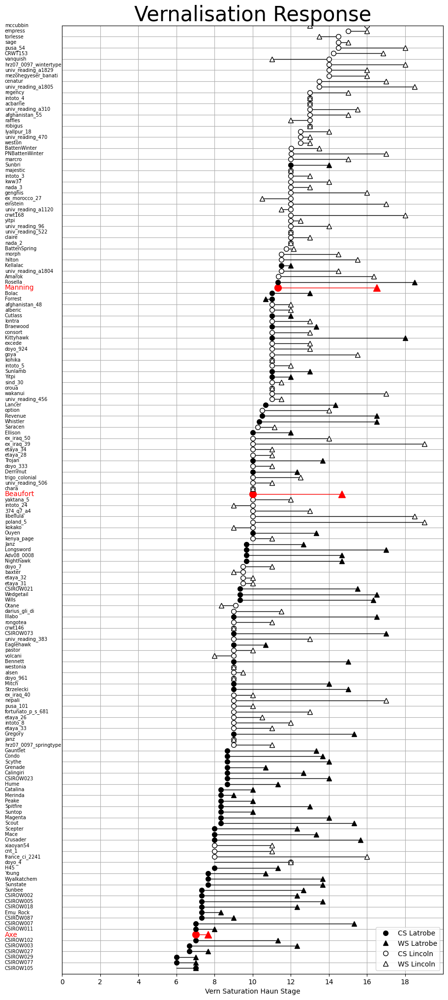

In [10]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Vernalisation Response',
                 highlights = ['Axe','Beaufort','Manning'],
                 Trts = ['FLN_CS','FLN_WS'],
                 sortT = 'FLN_CS',
                 xlab = 'Vern Saturation Haun Stage',
                 xmin = 0,
                 xmax = 20,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=1)

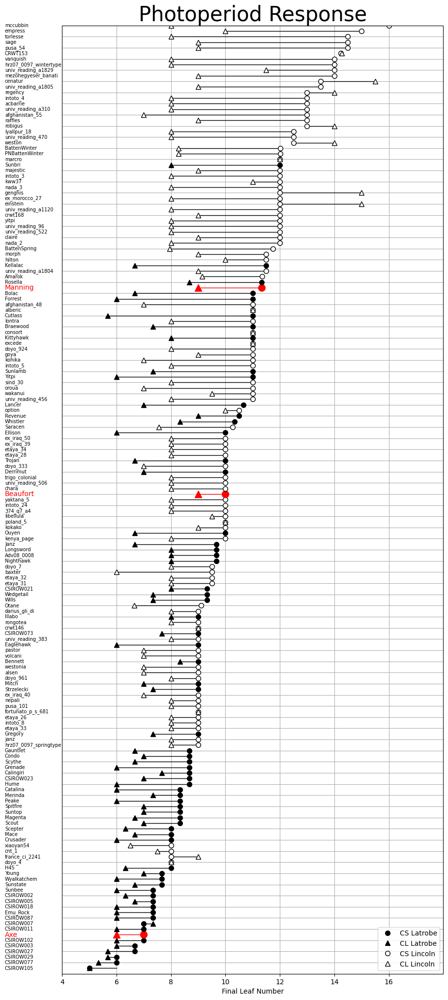

In [11]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Photoperiod Response',
                 highlights = ['Axe','Beaufort','Manning'],
                 Trts = ['FLN_CS','FLN_CL'],
                 sortT = 'FLN_CS',
                 xlab = 'Final Leaf Number',
                 xmin = 4,
                 xmax = 18,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=1)

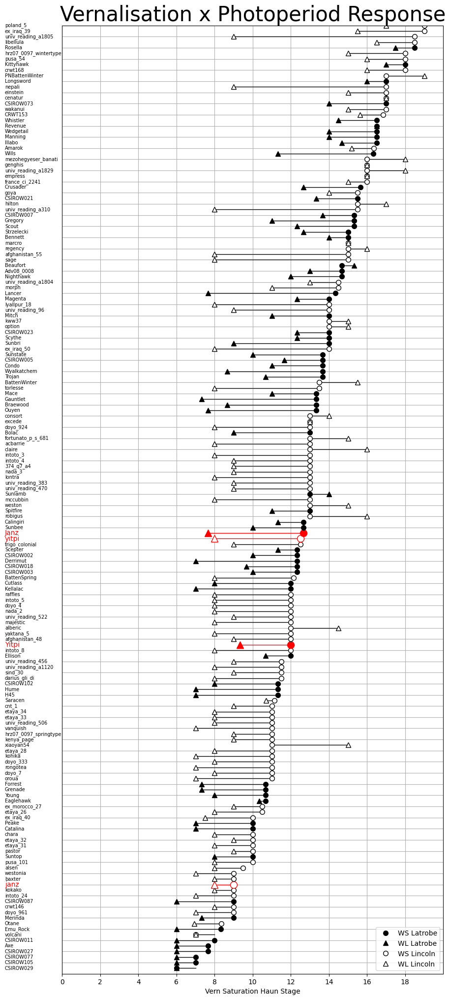

In [12]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Vernalisation x Photoperiod Response',
                 highlights = ['Janz','janz','Yitpi','yitpi'],
                 Trts = ['FLN_WS','FLN_WL'],
                 sortT = 'FLN_WS',
                 xlab = 'Vern Saturation Haun Stage',
                 xmin = 0,
                 xmax = 20,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=1)

In [13]:
graph = plt.figure(figsize=(20,600))
pan=1
CampVrnParams.loc
for c in CampVrnParams.index:
    params = camp.deriveVrnParams(CampInputs.loc[c,:])
    CampVrnParams.loc[c,params.index] = params
    ax = graph.add_subplot(171,4,pan)
    camp.plotVITS(params, 3,c)
    pan+=1
    ax = graph.add_subplot(171,4,pan)
    camp.boundPlots(params, ax, c)
    pan+=1
    ax = graph.add_subplot(171,4,pan)
    camp.Vrn2Plots(params,ax,c)  
    pan+=1
    ax = graph.add_subplot(171,4,pan)
    camp.Vrn1Plots(params, ax,c)  
    pan+=1

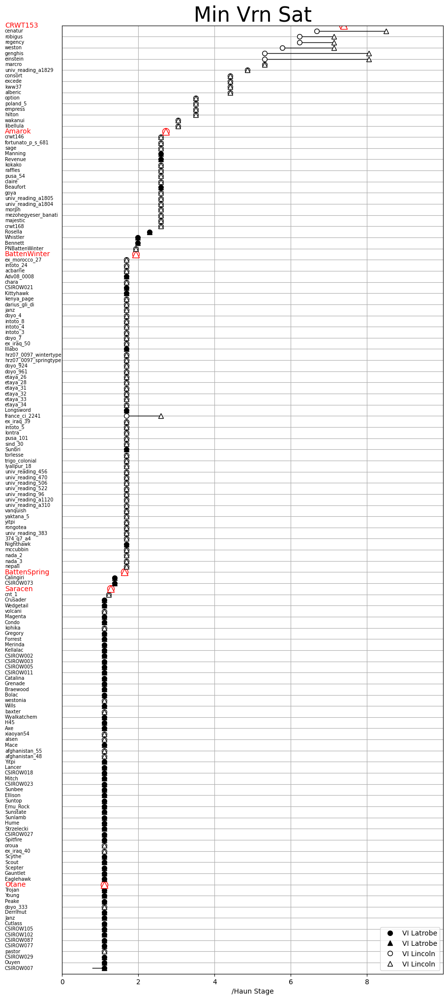

In [14]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Min Vrn Sat',
                 highlights = ['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153'],
                 Trts = ['VI_CS','VI_CL'],
                 sortT = 'VI_CS',
                 xlab = '/Haun Stage',
                 xmin = 0,
                 xmax = 10,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)
#plt.plot([0.476,0.476],[0,160])

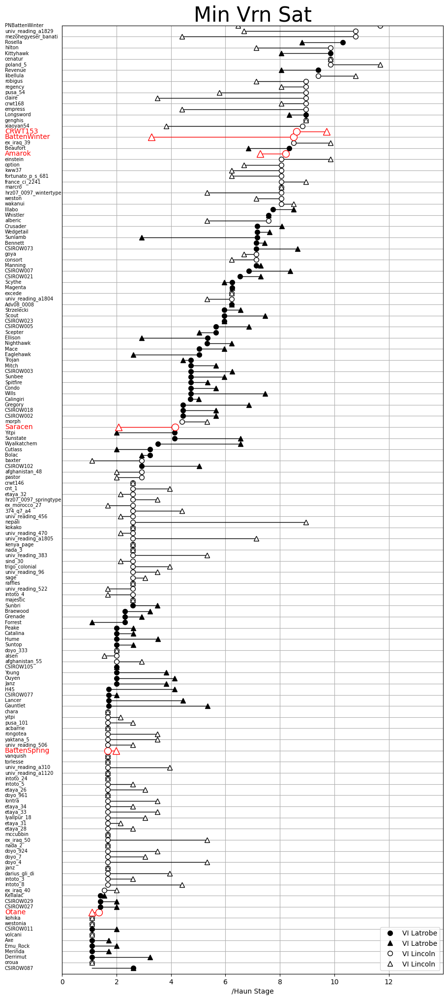

In [15]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Min Vrn Sat',
                 highlights = ['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153'],
                 Trts = ['VI_WL','VI_WS'],
                 sortT = 'VI_WL',
                 xlab = '/Haun Stage',
                 xmin = 0,
                 xmax = 14,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)
#plt.plot([0.476,0.476],[0,160])

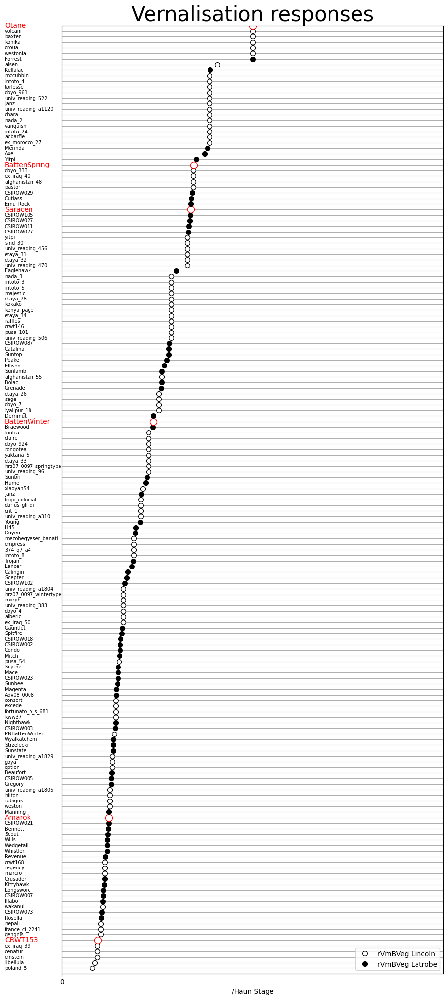

In [16]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Vernalisation responses',
                 highlights = ['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153'],
                 Trts = ['rVrnBVeg'],
                 sortT = 'rVrnBVeg',
                 xlab = '/Haun Stage',
                 xmin = 0,
                 xmax = 1,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)
#plt.plot([0.476,0.476],[0,160])

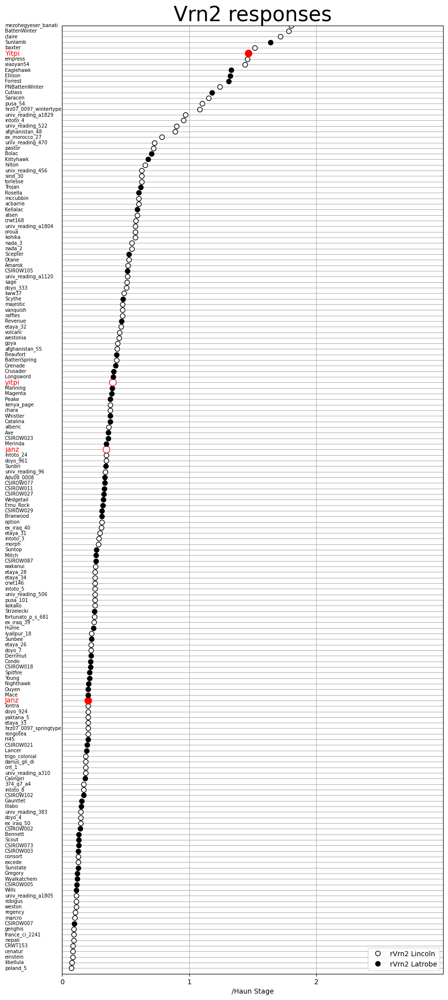

In [17]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Vrn2 responses',
                 highlights = ['Janz','janz','Yitpi','yitpi'],#['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153'],
                 Trts = ['rVrn2'],
                 sortT = 'rVrn2',
                 xlab = '/Haun Stage',
                 xmin = 0,
                 xmax = 3,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)

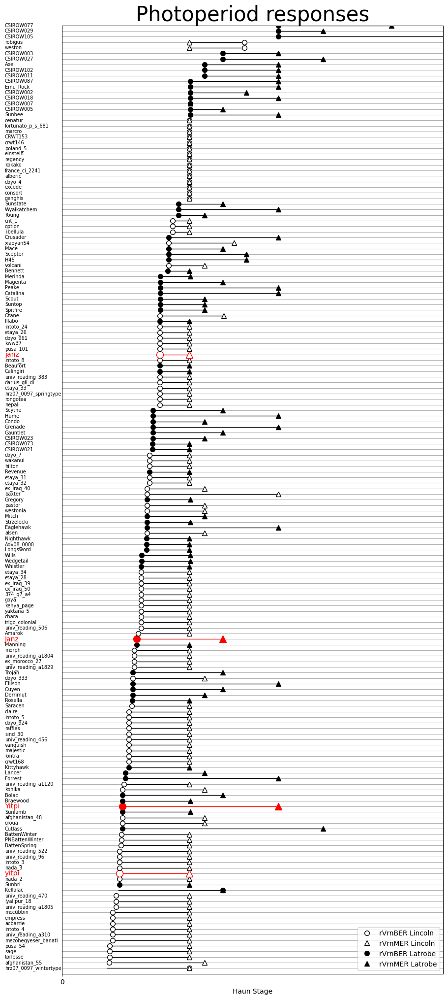

In [20]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Photoperiod responses',
                 highlights = ['Janz','janz','Yitpi','yitpi'],#['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153']
                 Trts = ['rVrnBER','rVrnMER'],
                 sortT = 'rVrnBER',
                 xlab = 'Haun Stage',
                 xmin = 0,
                 xmax = 1,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)

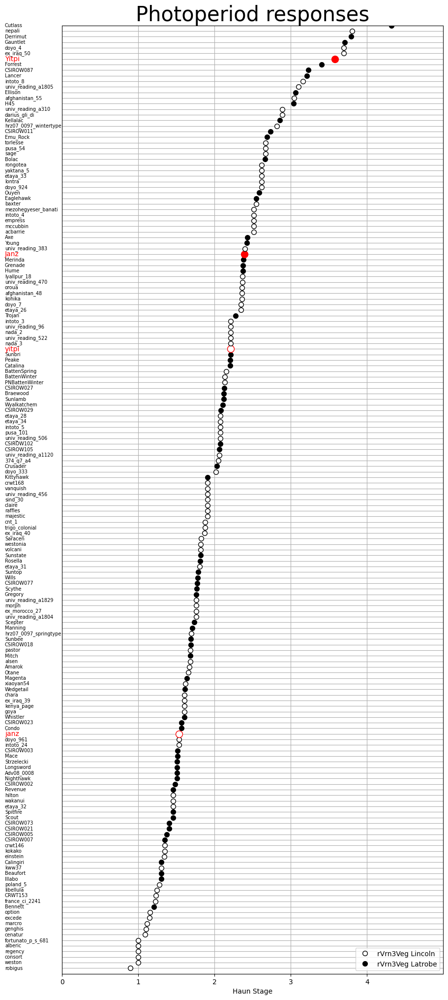

In [21]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Photoperiod responses',
                 highlights = ['Janz','janz','Yitpi','yitpi'],#['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153']
                 Trts = ['rVrn3Veg'],
                 sortT = 'rVrn3Veg',
                 xlab = 'Haun Stage',
                 xmin = 0,
                 xmax = 5,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)

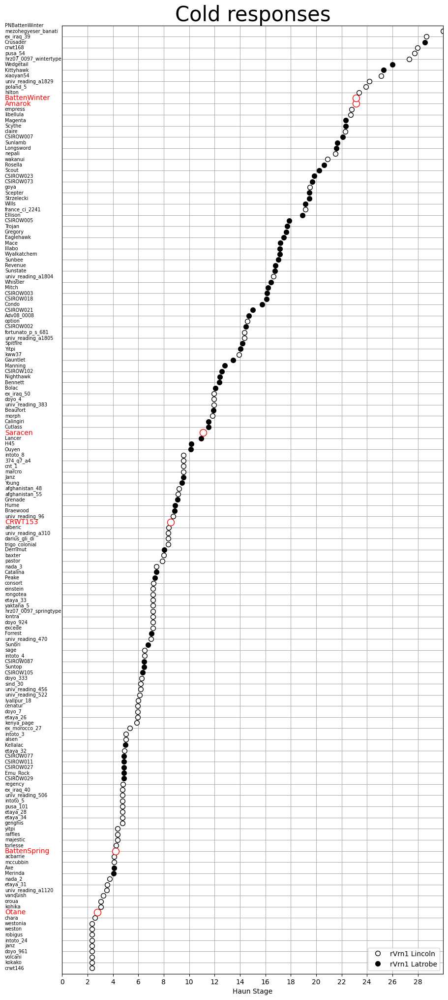

In [22]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'Cold responses',
                 highlights = ['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153'],
                 Trts = ['rVrn1'],
                 sortT = 'rVrn1',
                 xlab = 'Haun Stage',
                 xmin = 0,
                 xmax = 30,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)

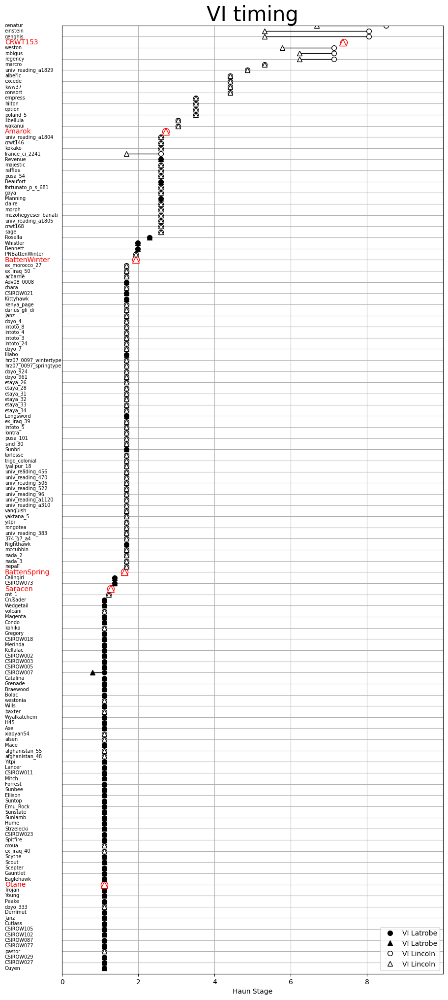

In [23]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'VI timing',
                 highlights = ['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153'],
                 Trts = ['VI_CL','VI_CS'],
                 sortT = 'VI_CL',
                 xlab = 'Haun Stage',
                 xmin = 0,
                 xmax = 10,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)

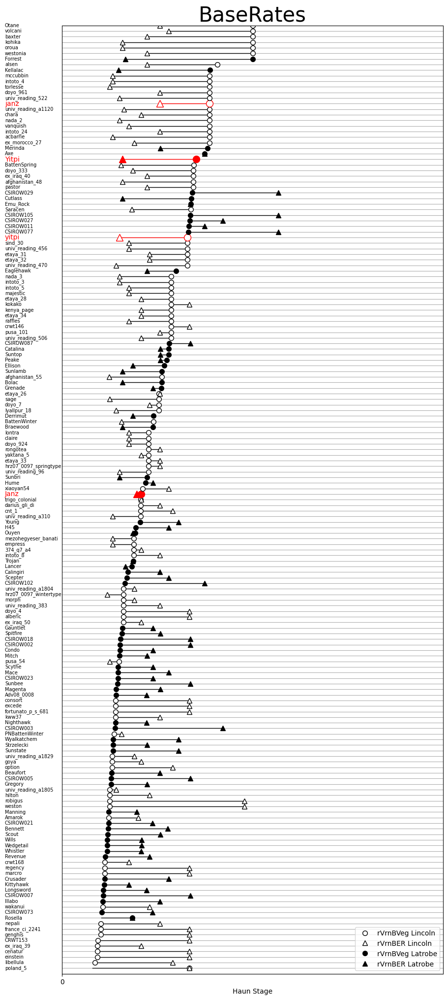

In [24]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'BaseRates',
                 highlights = ['Janz','janz','Yitpi','yitpi'],#['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153']
                 Trts = ['rVrnBVeg','rVrnBER'],
                 sortT = 'rVrnBVeg',
                 xlab = 'Haun Stage',
                 xmin = 0,
                 xmax = 1,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)

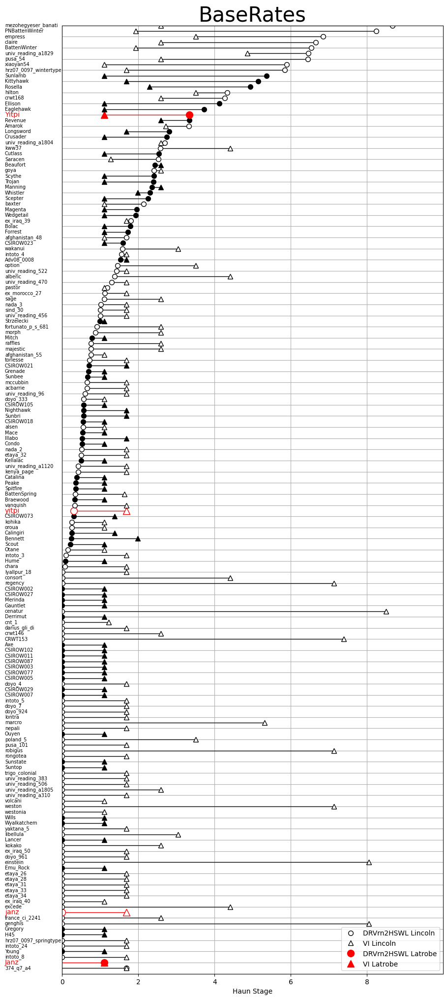

In [25]:
Graph = plt.figure(figsize=(10,25))
ax = Graph.add_subplot(1,1,1)
MakeResponsePlot(Title = 'BaseRates',
                 highlights = ['Janz','janz','Yitpi','yitpi'],#['Otane','BattenSpring','Saracen','Amarok','BattenWinter','CRWT153']
                 Trts = ['DRVrn2HSWL','VI_CL'],
                 sortT = 'DRVrn2HSWL',
                 xlab = 'Haun Stage',
                 xmin = 0,
                 xmax = 10,
                 ymin = -1,
                 ymax = 169,
                 LabLegPos=0)

In [26]:
CampVrnParams.to_excel('CampVrnParams.xlsx')

In [27]:
CampVrnParams.loc[['PNBattenWinter','BattenWinter'],:]

,FLN_CL,FLN_WL,FLN_CS,FLN_WS,Expt,MinLN,PpLN,VrnLN,VxPLN,TS_WS,...,DRVrn2HSWL,rVrn2,VrnPVI_CL,VrnBVeg_CL,Vrn1_CL,MethalationThreshold,CTHS,DVrn1_CL,DVrn1Max,rVrn1
Cultivar,,,,,,,,,,,,,,,,,,,,,
PNBattenWinter,8.277778,19.0,12.025,17.0,Lincoln,8.277778,3.747222,4.975,5.747222,12.863636,...,8.236726,1.241897,2.241897,0.385254,1.856643,1.856643,0.9,4.125873,4.890417,35.979146
BattenWinter,8.277778,15.5,12.025,13.5,Lincoln,8.277778,3.747222,1.475,5.747222,9.681818,...,6.544856,1.783091,2.783091,0.678844,2.104248,2.104248,0.9,4.676106,5.542611,23.141800
